In [ ]:
#ADS Project
#FOOD Recognition & Nutrition Analysis
#CS22B2008
#CS22B2032
#CS22B2042
#CS22B2043

# **DATA Pre-processing**

**Data Inspection**

In [ ]:
#import zipfile

#zip_ref=zipfile.ZipFile("/content/drive/MyDrive/data_set.zip",'r')
#zip_ref.extractall("/content/drive/MyDrive/")
#zip_ref.close()

In [ ]:
import os

# Define the folder path
folder_path = '/content/drive/MyDrive/test_food'

# List all the files in the folder
files = os.listdir(folder_path)

# Sort the files to ensure consistent numbering
files.sort()

# Initialize a serial number
serial_number = 1

# Iterate through each file in the folder and rename it with a serial number
for file_name in files:
    if os.path.isfile(os.path.join(folder_path, file_name)):
        # Generate the new file name with a serial number
        new_file_name = f"{serial_number:04d}.jpg"
        # Rename the file
        os.rename(os.path.join(folder_path, file_name), os.path.join(folder_path, new_file_name))
        # Increment the serial number for the next file
        serial_number += 1

print("All files in the folder have been renamed with serial numbers.")


All files in the folder have been renamed with serial numbers.


In [ ]:
import os
from PIL import Image

# Define the directory where your dataset is located
dataset_dir = "/content/drive/MyDrive/test_food"

# Get the list of files in the directory
file_list = os.listdir(dataset_dir)

# Check each file in the directory
for file_name in file_list:
    file_path = os.path.join(dataset_dir, file_name)

    try:
        # Try to open the file using PIL (Pillow)
        with Image.open(file_path) as img:
            img.load()
    except (IOError, OSError) as e:
        # Handle the exception if the file cannot be opened
        print(f"Error with file: {file_name} - {e}")

print("Dataset inspection complete.")


Error with file: 0040.jpg - cannot identify image file '/content/drive/MyDrive/test_food/0040.jpg'
Dataset inspection complete.


In [ ]:
import os
import warnings
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

warnings.filterwarnings("ignore")

In [ ]:
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.preprocessing import image
from tensorflow.keras import models
from tensorflow.keras.models import load_model
from tensorflow.keras import models
from PIL import Image
from skimage.io import imread
import cv2

K.clear_session()


**Data** **Visualization**


In [ ]:
img = plt.imread('/content/drive/MyDrive/data_set/train/Banana/0001.jpg')
dims = np.shape(img)
matrix = np.reshape(img, (dims[0] * dims[1], dims[2]))
print(np.shape(matrix))

(9000000, 3)


Image shape ->  (2250, 4000)
Color channels ->  3
Min color depth : 0, Max color depth 255


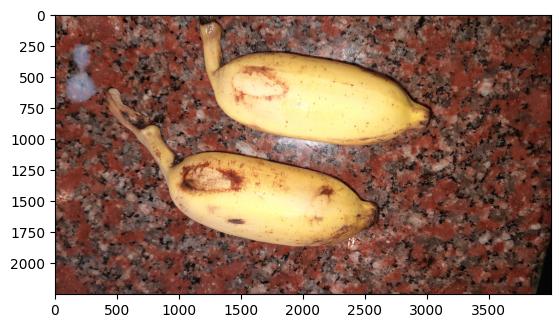

In [ ]:
plt.imshow(img)
print("Image shape -> ",dims[:2])
print("Color channels -> ",dims[2])
print("Min color depth : {}, Max color depth {}".format(np.min(img),np.max(img)))

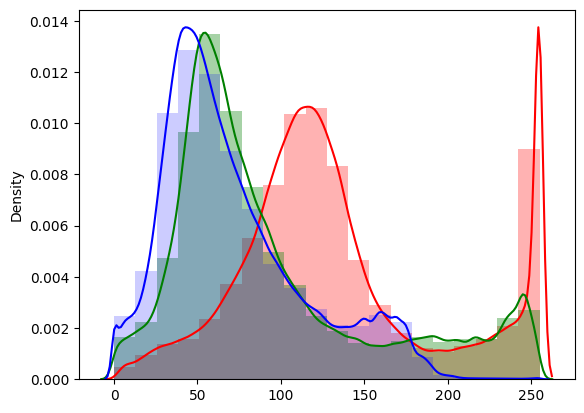

In [ ]:
sns.distplot(matrix[:,0], bins=20,color="red",hist_kws=dict(alpha=0.3))
sns.distplot(matrix[:,1], bins=20,color="green",hist_kws=dict(alpha=0.35))
sns.distplot(matrix[:,2], bins=20,color="blue",hist_kws=dict(alpha=0.2))
plt.show()

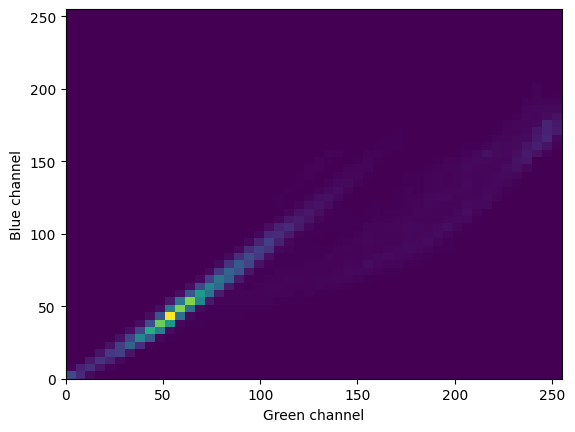

In [ ]:
_ = plt.hist2d(matrix[:,1], matrix[:,2], bins=(50,50))
plt.xlabel('Green channel')
plt.ylabel('Blue channel')
plt.show()


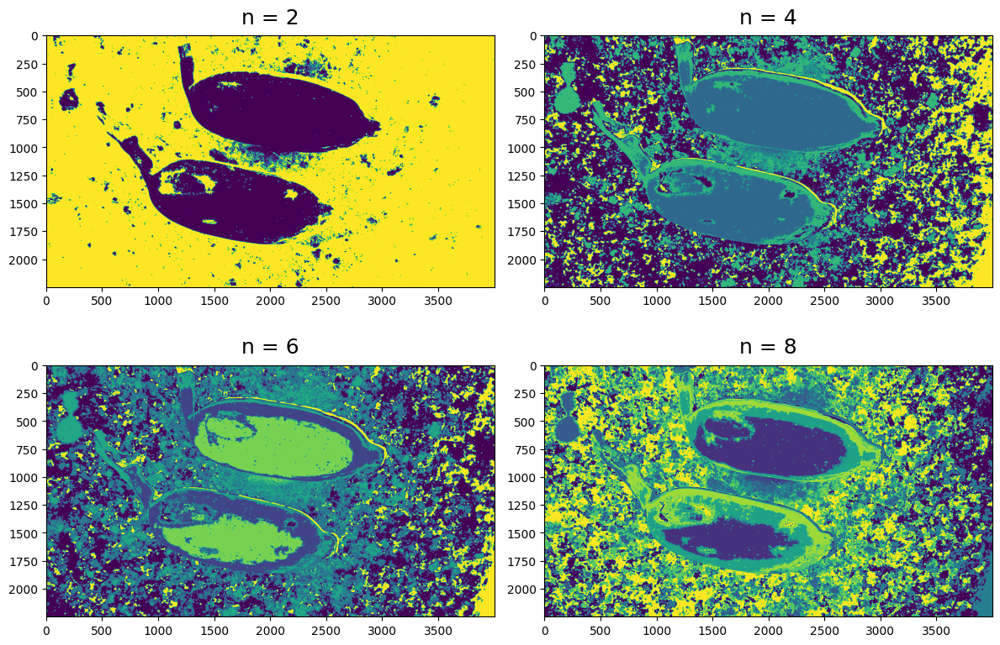

In [ ]:
from sklearn import cluster
n_vals=[2,4,6,8]
plt.figure(1, figsize=(12, 8))

for subplot,n in enumerate(n_vals):
    kmeans=cluster.KMeans(n)
    clustered = kmeans.fit_predict(matrix)
    dims = np.shape(img)
    clustered_img = np.reshape(clustered, (dims[0], dims[1]))
    plt.subplot(2,2, subplot+1)
    plt.title("n = {}".format(n), pad = 10,size=18)
    plt.imshow(clustered_img)

plt.tight_layout()

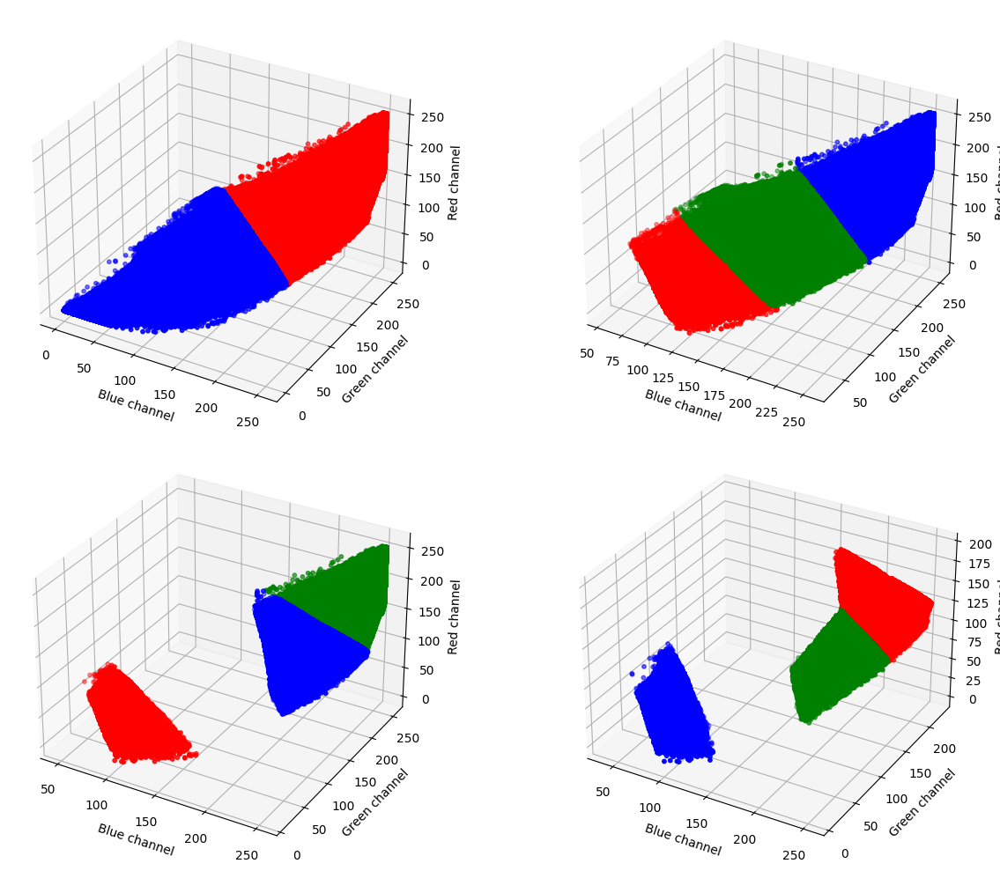

In [ ]:
from mpl_toolkits.mplot3d import Axes3D

fig=plt.figure(figsize=(14,10))

ax = [fig.add_subplot(221, projection='3d'),
      fig.add_subplot(222, projection='3d'),
      fig.add_subplot(223, projection='3d'),
      fig.add_subplot(224, projection='3d')]

for plot_number,n in enumerate(n_vals):

    kmeans=cluster.KMeans(n)
    clustered = kmeans.fit_predict(matrix)
    x1, y1, z1 = [np.where(clustered == x)[0] for x in [0, 1, 2]]

    plot_vals = [('r', x1),
                 ('b', y1),
                 ('g', z1),
                 ]

    for c, channel in plot_vals:
        x = matrix[channel, 0]
        y = matrix[channel, 1]
        z = matrix[channel, 2]
        ax[plot_number].scatter(x, y, z, c=c,s=10)

    ax[plot_number].set_xlabel('Blue channel')
    ax[plot_number].set_ylabel('Green channel')
    ax[plot_number].set_zlabel('Red channel')

plt.tight_layout()

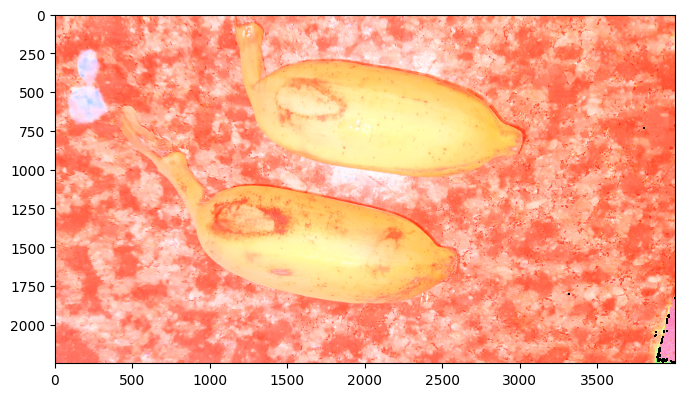

In [ ]:
bnorm = np.zeros_like(matrix, dtype=np.float32)
max_range = np.max(matrix, axis=1)
bnorm = matrix / np.vstack((max_range, max_range, max_range)).T
bnorm_img = np.reshape(bnorm, (dims[0],dims[1],dims[2]))
plt.figure(figsize=(8,10))
plt.imshow(bnorm_img)
plt.show()

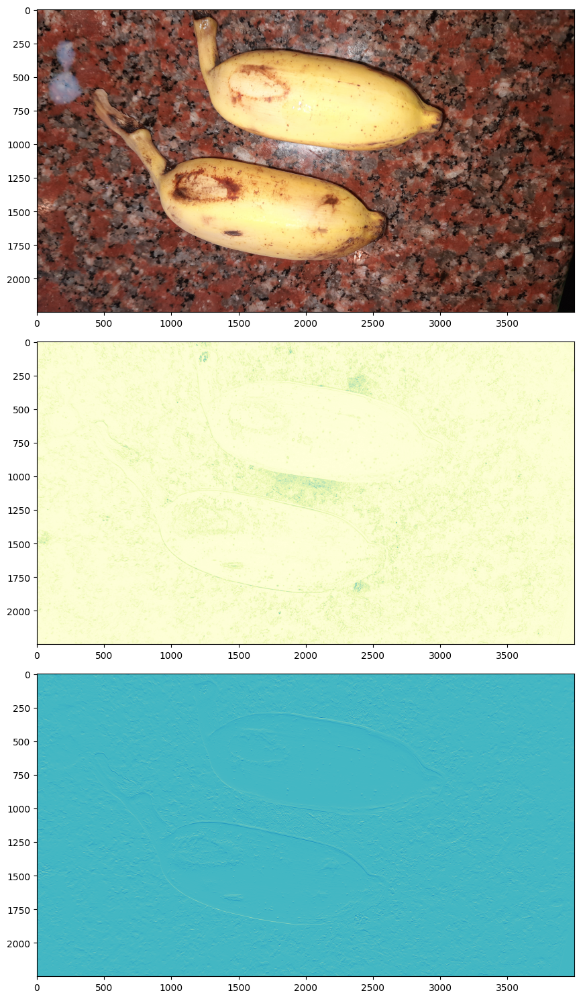

In [ ]:
import skimage
from skimage.feature import greycomatrix, greycoprops
from skimage.filters import sobel
from skimage.filters import sobel_h

plt.figure(1,figsize=(20,15))
cmap="YlGnBu"
plt.subplot(3,1,1)
plt.imshow(img)

plt.subplot(3,1,2)
plt.imshow(sobel(img[:,:,2]),cmap=cmap)

plt.subplot(3,1,3)
plt.imshow(sobel_h(img[:,:,1]), cmap=cmap)

plt.tight_layout()

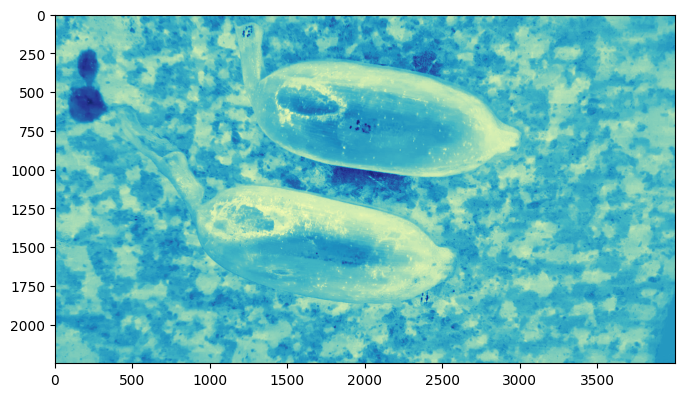

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(3)
pca.fit(matrix)
img_pca = pca.transform(matrix)
img_pca = np.reshape(img_pca, (dims[0], dims[1], dims[2]))

fig = plt.figure(figsize=(8, 8))
plt.imshow(img_pca[:,:,1], cmap=cmap)

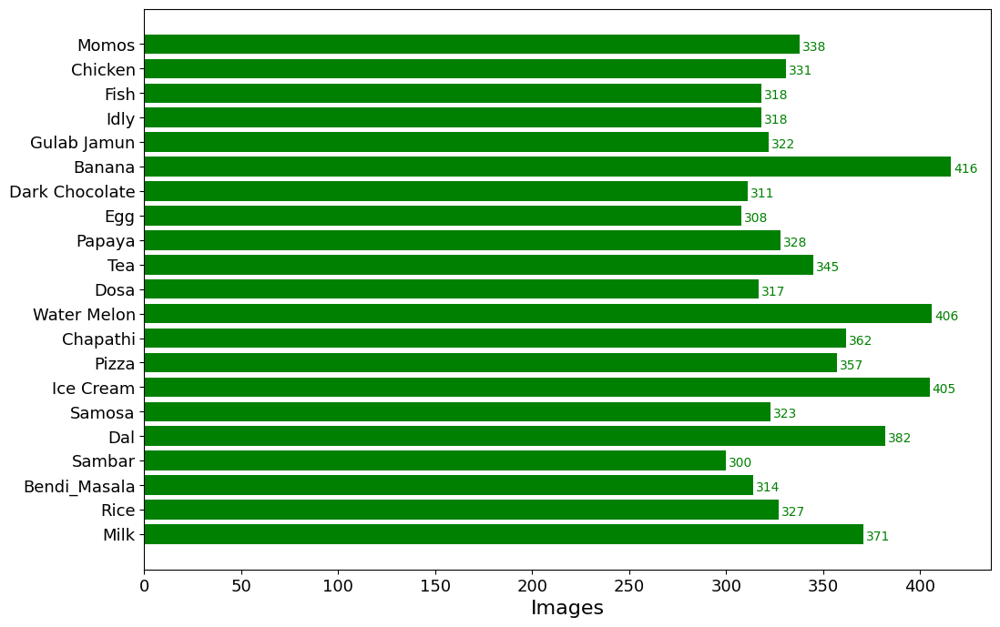

In [ ]:
main='/content/drive/MyDrive/data_set/train'

data=dict()

for i in os.listdir(main):
    sub_dir=os.path.join(main,i)
    count=len(os.listdir(sub_dir))
    data[i]=count


keys = data.keys()
values = data.values()

colors=["red" if x<= 299 else "green" for x in values]

fig, ax = plt.subplots(figsize=(12,8))
y_pos=np.arange(len(values))
plt.barh(y_pos,values,align='center',color=colors)
for i, v in enumerate(values):
    ax.text(v+1.4, i-0.25, str(v), color=colors[i])
ax.set_yticks(y_pos)
ax.set_yticklabels(keys)
ax.set_xlabel('Images',fontsize=16)
plt.xticks(color='black',fontsize=13)
plt.yticks(fontsize=13)
plt.show()

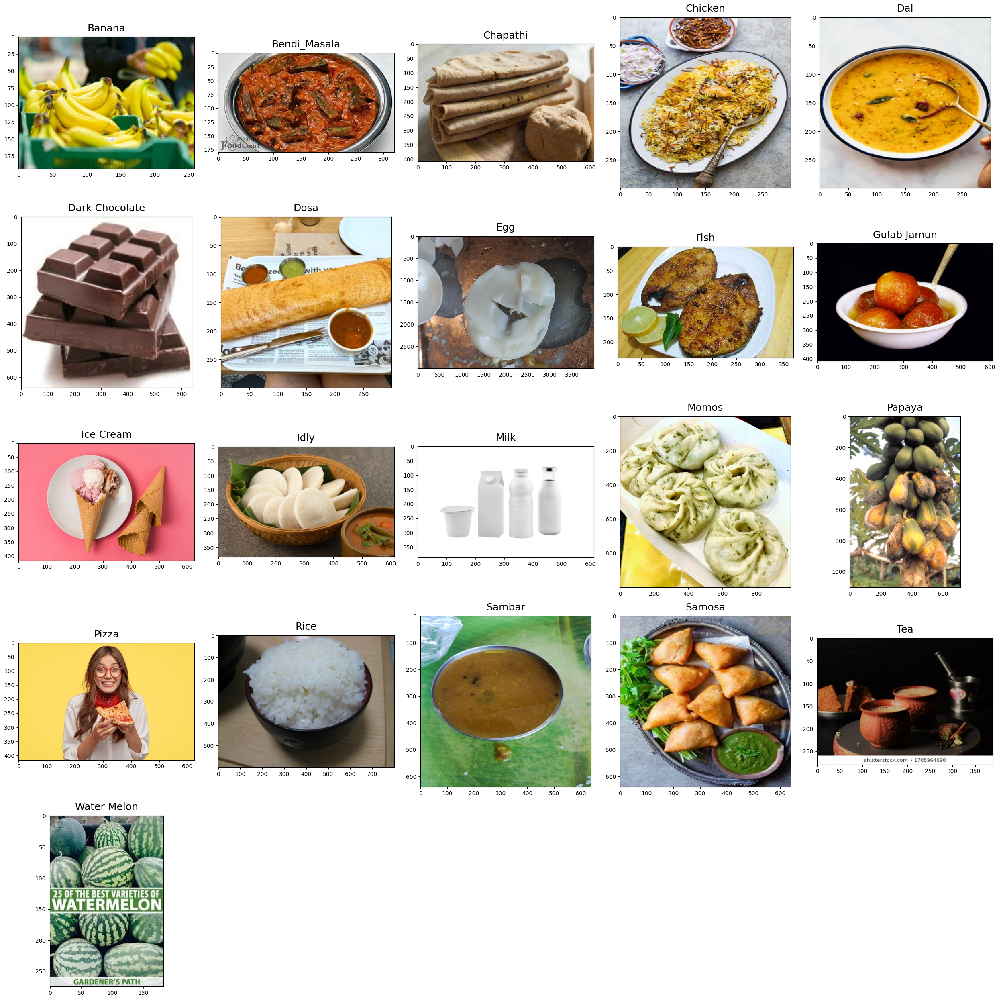

In [ ]:
import random

train_folder = "/content/drive/MyDrive/data_set/train"
images = []

for food_folder in sorted(os.listdir(train_folder)):
    food_items = os.listdir(train_folder + '/' + food_folder)
    food_selected = np.random.choice(food_items)
    images.append(os.path.join(train_folder,food_folder,food_selected))

fig=plt.figure(1, figsize=(25, 25))

for subplot,image_ in enumerate(images):
    category=image_.split('/')[-2]
    imgs = plt.imread(image_)
    a,b,c=imgs.shape
    fig=plt.subplot(5, 5, subplot+1)
    fig.set_title(category, pad = 10,size=18)
    plt.imshow(imgs)

plt.tight_layout()

**Data** **Augmentation**

In [ ]:
#Training the model

from tensorflow.keras.preprocessing.image import ImageDataGenerator

n_classes = 21
batch_size = 16
img_width, img_height = 299, 299

train_data_dir = '/content/drive/MyDrive/data_set/train'

# Data Augmentation with ImageDataGenerator
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    rotation_range = 40,
    width_shift_range = 0.2,
    validation_split = 0.2,
    height_shift_range = 0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

train_generator = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')


test_data_dir = '/content/drive/MyDrive/data_set/test'

test_datagen = ImageDataGenerator(rescale=1. / 255)

test_generator = test_datagen.flow_from_directory(
    test_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')


val_data_dir = '/content/drive/MyDrive/data_set/validation'

val_datagen = ImageDataGenerator(rescale=1. / 255)

val_generator = val_datagen.flow_from_directory(
    val_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')
#10093

Found 7199 images belonging to 21 classes.
Found 1417 images belonging to 21 classes.
Found 1494 images belonging to 21 classes.


In [ ]:
print(len(train_generator)*16)
len(val_generator)*16
print(len(test_generator)*16)


7200


1504

In [ ]:
class_map = train_generator.class_indices
class_map

{'Banana': 0,
 'Bendi_Masala': 1,
 'Chapathi': 2,
 'Chicken': 3,
 'Dal': 4,
 'Dark Chocolate': 5,
 'Dosa': 6,
 'Egg': 7,
 'Fish': 8,
 'Gulab Jamun': 9,
 'Ice Cream': 10,
 'Idly': 11,
 'Milk': 12,
 'Momos': 13,
 'Papaya': 14,
 'Pizza': 15,
 'Rice': 16,
 'Sambar': 17,
 'Samosa': 18,
 'Tea': 19,
 'Water Melon': 20}

In [ ]:
print(tf.__version__)
print(tf.test.gpu_device_name())

2.14.0
/device:GPU:0


# **Training the Model(Inception V3)**

In [ ]:
from tensorflow.keras.applications.inception_v3 import InceptionV3
# from tensorflow.keras.layers import Convolution2D, MaxPooling2D, ZeroPadding2D, GlobalAveragePooling2D, AveragePooling2D
# from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten

from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.layers import Dense, Dropout

from tensorflow.keras import regularizers
from tensorflow.keras.regularizers import l2

from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import ModelCheckpoint, CSVLogger

nb_train_samples = 7055
nb_validation_samples = 1382

inception = InceptionV3(weights='imagenet', include_top=False)
x = inception.output
x = GlobalAveragePooling2D()(x)
x = Dense(128,activation='relu')(x)
x = Dropout(0.2)(x)

predictions = Dense(n_classes,kernel_regularizer=regularizers.l2(0.005), activation='softmax')(x)

model = Model(inputs=inception.input, outputs=predictions)
model.compile(optimizer=SGD(lr=0.0001, momentum=0.9), loss='categorical_crossentropy', metrics=['accuracy'])
checkpointer = ModelCheckpoint(filepath='v1_inceptionV3', verbose=1, save_best_only=True)
csv_logger = CSVLogger('history_v1_inceptionV3.log')

history = model.fit_generator(train_generator,
                    steps_per_epoch = nb_train_samples // batch_size,
                    validation_data=val_generator,
                    validation_steps=nb_validation_samples // batch_size,
                    epochs=20,
                    verbose=1,
                    callbacks=[csv_logger, checkpointer])

87910968/87910968 [==============================] - 0s 0us/step


Epoch 1/20
440/440 [==============================] - ETA: 0s - loss: 1.5991 - accuracy: 0.5843
Epoch 1: val_loss improved from inf to 2.29768, saving model to v1_inceptionV3
440/440 [==============================] - 2538s 6s/step - loss: 1.5991 - accuracy: 0.5843 - val_loss: 2.2977 - val_accuracy: 0.5429
Epoch 2/20
440/440 [==============================] - ETA: 0s - loss: 0.9876 - accuracy: 0.7434
Epoch 2: val_loss improved from 2.29768 to 1.23627, saving model to v1_inceptionV3
440/440 [==============================] - 335s 761ms/step - loss: 0.9876 - accuracy: 0.7434 - val_loss: 1.2363 - val_accuracy: 0.6940
Epoch 3/20
440/440 [==============================] - ETA: 0s - loss: 0.7763 - accuracy: 0.8024
Epoch 3: val_loss did not improve from 1.23627
440/440 [==============================] - 250s 567ms/step - loss: 0.7763 - accuracy: 0.8024 - val_loss: 1.3248 - val_accuracy: 0.6737
Epoch 4/20
440/440 [==============================] - ETA: 0s - loss: 0.6570 - accuracy: 0.8371
Epoc

In [ ]:
model.save('model_v1_inceptionV3.h5')

In [ ]:
def plot_accuracy(history):

    plt.plot(history.history['accuracy'],label='train accuracy')
    plt.plot(history.history['val_accuracy'],label='validation accuracy')
    plt.title('Model accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Accuracy_v1_InceptionV3')
    plt.show()

def plot_loss(history):

    plt.plot(history.history['loss'],label="train loss")
    plt.plot(history.history['val_loss'],label="validation loss")
    plt.title('Model loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(loc='best')
    plt.savefig('Loss_v1_InceptionV3')
    plt.show()

plot_accuracy(history)
plot_loss(history)

NameError: ignored

**Loading the Model**

In [ ]:
K.clear_session()
path_to_model='./model_v1_inceptionV3.h5'
print("Loading the model..")
model = load_model(path_to_model)
print("Done!")

NameError: ignored

# **Testing the Model**

In [ ]:
test_data_dir = '/content/drive/MyDrive/data_set/test'
test_datagen = ImageDataGenerator(rescale=1. / 255)

test_generator = test_datagen.flow_from_directory(
    test_data_dir,
    target_size=(img_height, img_width),
    batch_size=batch_size,
    class_mode='categorical')

Found 1417 images belonging to 21 classes.


In [ ]:
scores = model.evaluate_generator(test_generator)

print("Test Accuracy: {:.3f}".format(scores[1]))

Test Accuracy: 0.808


In [ ]:
category={
    0: ['Banana','Banana'], 1: ['Bendi_Masala','Ladies Finger Curry'], 2: ['Chapathi','Chapathi'],
    3: ['Chicken','Chicken'], 4: ['Dal','Dal'], 5: ['Dark Chocolate','Dark Chocolate'],
    6: ['Dosa','Dosa'], 7: ['Egg','Egg'], 8: ['Fish','Fish'], 9: ['Gulab Jamun','Gulab Jamun'],
    10: ['Ice Cream','Ice Cream'], 11: ['Idly','Idly'], 12: ['Milk','Milk'],
    13: ['Momos','Momos'], 14: ['Papaya','Papaya'], 15: ['Pizza','Pizza'],
    16: ['Rice','Rice'], 17: ['Sambar','Sambar'], 18: ['Samosa','Samosa'], 19: ['Tea','Tea'],
    20: ['Water Melon','Water Melon']
}

def predict_image(filename,model):
    img_ = image.load_img(filename, target_size=(224, 224))
    img_array = image.img_to_array(img_)
    img_processed = np.expand_dims(img_array, axis=0)
    img_processed /= 255.

    prediction = model.predict(img_processed)

    index = np.argmax(prediction)

    plt.title("Prediction - {}".format(category[index][1]))
    plt.imshow(img_array)

def predict_dir(filedir,model):
    cols=5
    pos=0
    images=[]
    total_images=len(os.listdir(filedir))
    rows=total_images//cols + 1

    true=filedir.split('/')[-1]

    fig=plt.figure(1, figsize=(25, 25))

    for i in sorted(os.listdir(filedir)):
        images.append(os.path.join(filedir,i))

    for subplot,imggg in enumerate(images):
        img_ = image.load_img(imggg, target_size=(224, 224))
        img_array = image.img_to_array(img_)

        img_processed = np.expand_dims(img_array, axis=0)

        img_processed /= 255.
        prediction = model.predict(img_processed)
        index = np.argmax(prediction)

        pred=category.get(index)[0]
        if pred==true:
            pos+=1

        fig=plt.subplot(rows, cols, subplot+1)
        fig.set_title(category.get(index)[1], pad = 10,size=18)
        plt.imshow(img_array)

    acc=pos/total_images
    print("Accuracy of Test : {:.2f} ({pos}/{total})".format(acc,pos=pos,total=total_images))
    plt.tight_layout()


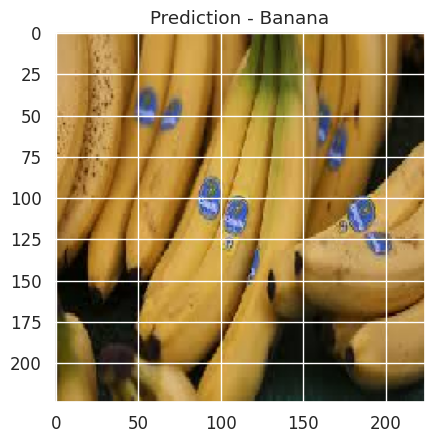

In [ ]:
predict_image('/content/drive/MyDrive/Banana (2182).jpeg',model)


Accuracy of Test : 0.00 (0/46)


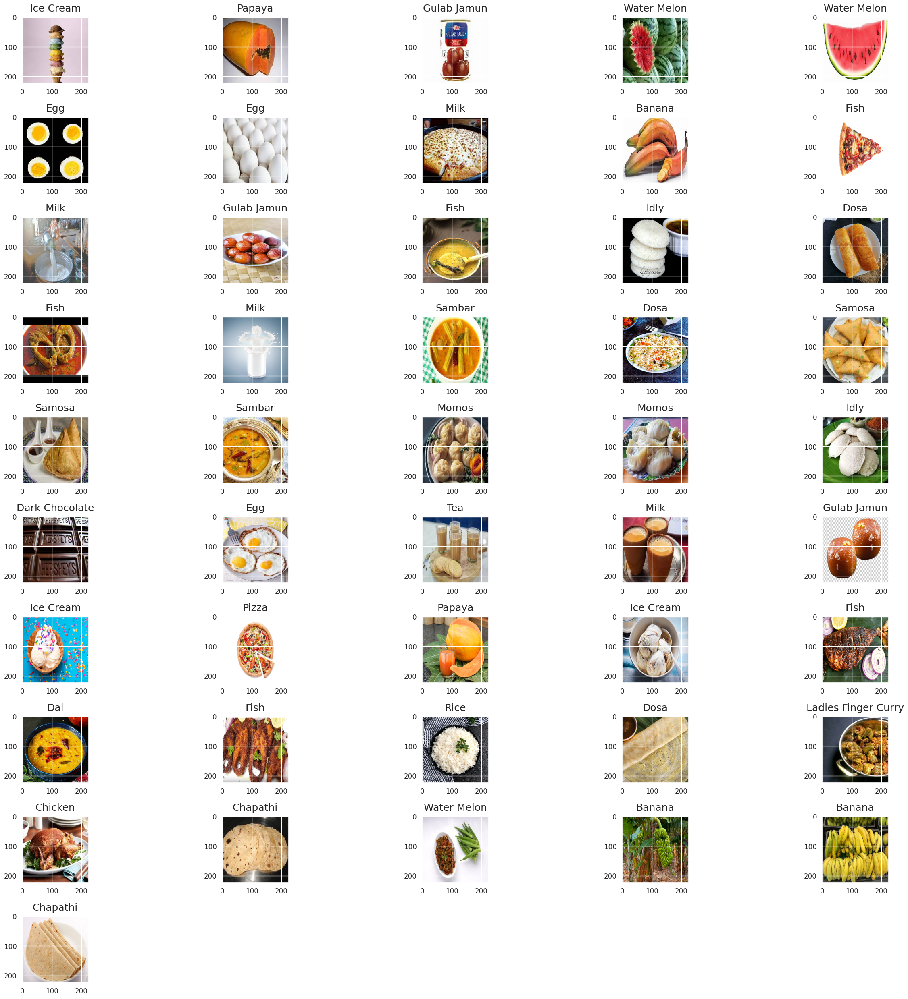

In [ ]:
predict_dir("/content/drive/MyDrive/test_food",model)

In [ ]:
from sklearn.metrics import confusion_matrix
import itertools

img_width, img_height = 299, 299

def labels_confusion_matrix():
    folder_path="/content/drive/MyDrive/data_set/test"

    mapping={}
    for i,j in enumerate(sorted(os.listdir(folder_path))):
        mapping[j]=i

    files=[]
    real=[]
    predicted=[]

    for i in os.listdir(folder_path):

        true=os.path.join(folder_path,i)
        true=true.split('/')[-1]
        true=mapping[true]

        for j in os.listdir(os.path.join(folder_path,i)):

            img_ = image.load_img(os.path.join(folder_path,i,j), target_size=(img_height, img_width))
            img_array = image.img_to_array(img_)
            img_processed = np.expand_dims(img_array, axis=0)
            img_processed /= 255.
            prediction = model.predict(img_processed)
            index = np.argmax(prediction)

            predicted.append(index)
            real.append(true)

    return (real,predicted)

def print_confusion_matrix(real,predicted):

    cmap="viridis"
    cm_plot_labels = [i for i in range(21)]

    cm = confusion_matrix(y_true=real, y_pred=predicted)
    df_cm = pd.DataFrame(cm,cm_plot_labels,cm_plot_labels)
    sns.set(font_scale=1.1) # for label size
    plt.figure(figsize = (15,10))
    s=sns.heatmap(df_cm, annot=True,cmap=cmap) # font size
#     bottom,top=s.get_ylim()
#     s.set_ylim(bottom+0.6,top-0.6)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.savefig('confusion_matrix.png')
    plt.show()

1/1 [==============================] - 0s 27ms/step


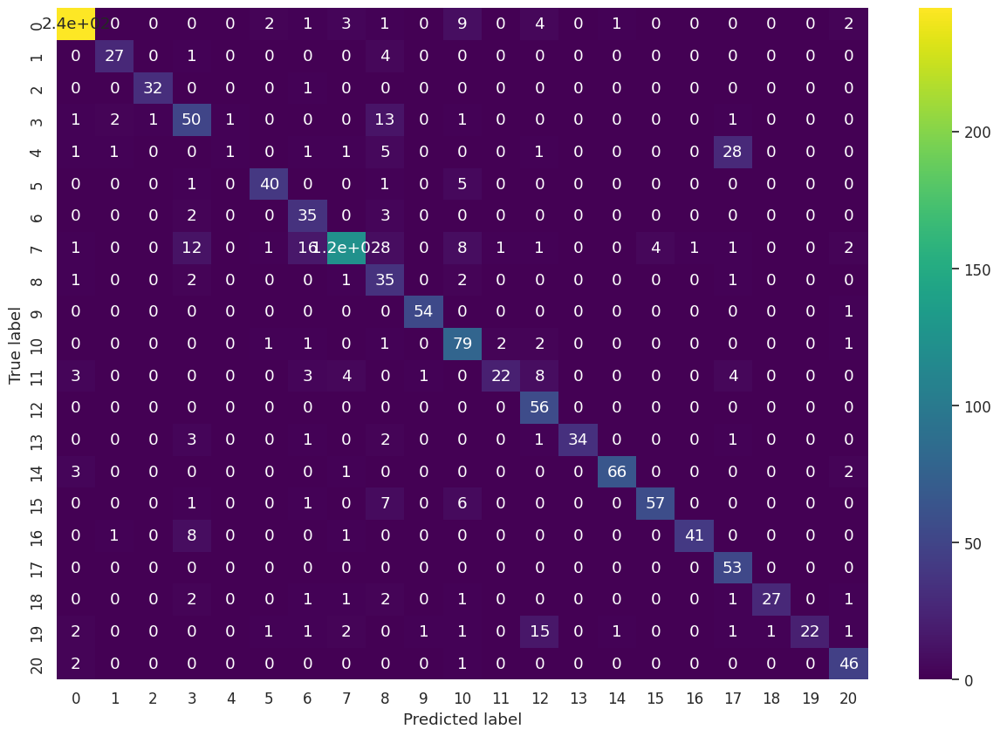

In [ ]:
y_true,y_pred=labels_confusion_matrix()
print_confusion_matrix(y_true,y_pred)

In [ ]:
def get_activations(img, model_activations):
    img = image.load_img(img, target_size=(299, 299))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img /= 255.
    plt.imshow(img[0])
    plt.show()
    return model_activations.predict(img)

def show_activations(activations, layer_names):

    images_per_row = 16

    # Now let's display our feature maps
    for layer_name, layer_activation in zip(layer_names, activations):
        # This is the number of features in the feature map
        n_features = layer_activation.shape[-1]

        # The feature map has shape (1, size, size, n_features)
        size = layer_activation.shape[1]

        # We will tile the activation channels in this matrix
        n_cols = n_features // images_per_row
        display_grid = np.zeros((size * n_cols, images_per_row * size))

        # We'll tile each filter into this big horizontal grid
        for col in range(n_cols):
            for row in range(images_per_row):
                channel_image = layer_activation[0,:, :,col * images_per_row + row]
                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size,row * size : (row + 1) * size] = channel_image

        # Display the grid
        scale = 1. / size
        plt.figure(figsize=(scale * display_grid.shape[1],
                            scale * display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='viridis')

    plt.show()

def activation_conv():
    first_convlayer_activation = activations[0]
    second_convlayer_activation = activations[3]
    third_convlayer_activation = activations[6]
    f,ax = plt.subplots(1,3, figsize=(10,10))
    ax[0].imshow(first_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[0].axis('OFF')
    ax[0].set_title('Conv2d_1')
    ax[1].imshow(second_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[1].axis('OFF')
    ax[1].set_title('Conv2d_2')
    ax[2].imshow(third_convlayer_activation[0, :, :, 3], cmap='viridis')
    ax[2].axis('OFF')
    ax[2].set_title('Conv2d_3')


def get_attribution(food):

    tf.compat.v1.disable_eager_execution()

    img = image.load_img(food, target_size=(299, 299))
    img = image.img_to_array(img)
    img /= 255.
    f,ax = plt.subplots(1,3, figsize=(15,15))
    ax[0].imshow(img)

    img = np.expand_dims(img, axis=0)
    model = load_model('./model_v1_inceptionV3.h5')

    preds = model.predict(img)
    class_id = np.argmax(preds[0])
    ax[0].set_title("Input Image")
    class_output = model.output[:, class_id]
    last_conv_layer = model.get_layer("mixed10")

    grads = K.gradients(class_output, last_conv_layer.output)[0]
    pooled_grads = K.mean(grads, axis=(0, 1, 2))
    iterate = K.function([model.input], [pooled_grads, last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([img])
    for i in range(2048):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap)
    ax[1].imshow(heatmap)
    ax[1].set_title("Heat map")


    act_img = cv2.imread(food)
    heatmap = cv2.resize(heatmap, (act_img.shape[1], act_img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed = cv2.addWeighted(act_img, 0.6, heatmap, 0.4, 0)
    cv2.imwrite('classactivation.png', superimposed)
    img_act = image.load_img('classactivation.png', target_size=(299, 299))
    ax[2].imshow(img_act)
    ax[2].set_title("Class Activation")
    plt.show()
    return preds

In [ ]:
print("Total layers in the model : ",len(model.layers),"\n")

# We start with index 1 instead of 0, as input layer is at index 0
layers = [layer.output for layer in model.layers[1:11]]
# We now initialize a model which takes an input and outputs the above chosen layers
activations_output = models.Model(inputs=model.input, outputs=layers)
# print(layers)

layer_names = []
for layer in model.layers[1:11]:
    layer_names.append(layer.name)

print("First 10 layers which we can visualize are -> ", layer_names)

Total layers in the model :  315 

First 10 layers which we can visualize are ->  ['conv2d', 'batch_normalization', 'activation', 'conv2d_1', 'batch_normalization_1', 'activation_1', 'conv2d_2', 'batch_normalization_2', 'activation_2', 'max_pooling2d']


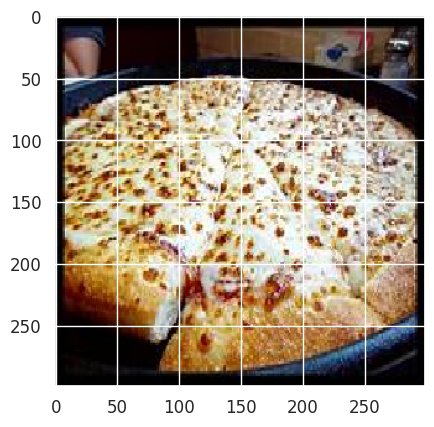

1/1 [==============================] - 0s 221ms/step


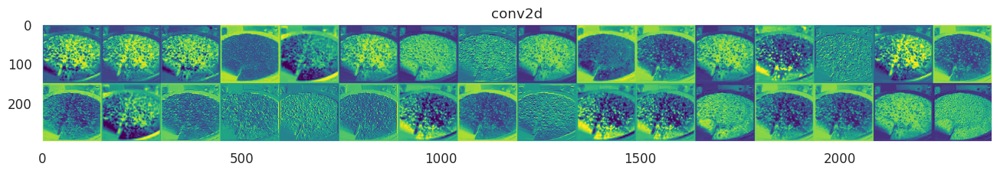

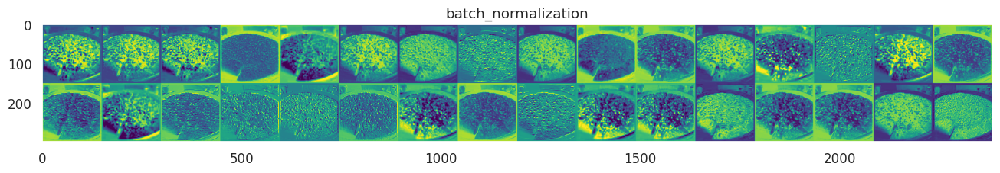

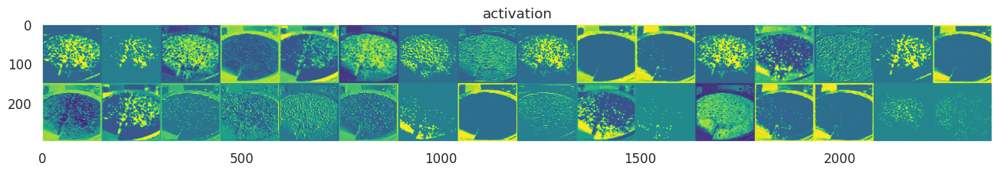

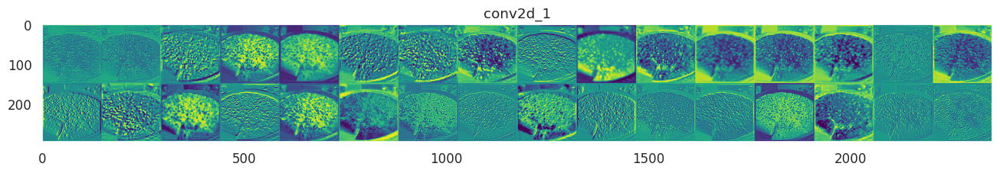

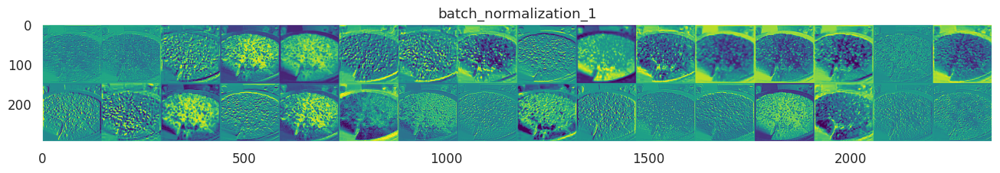

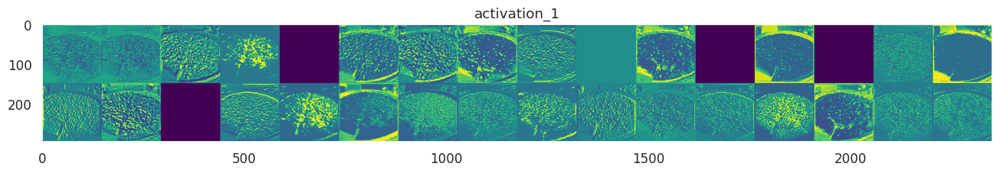

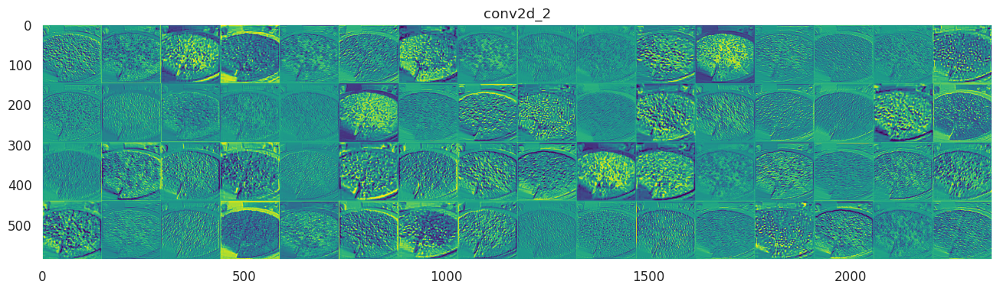

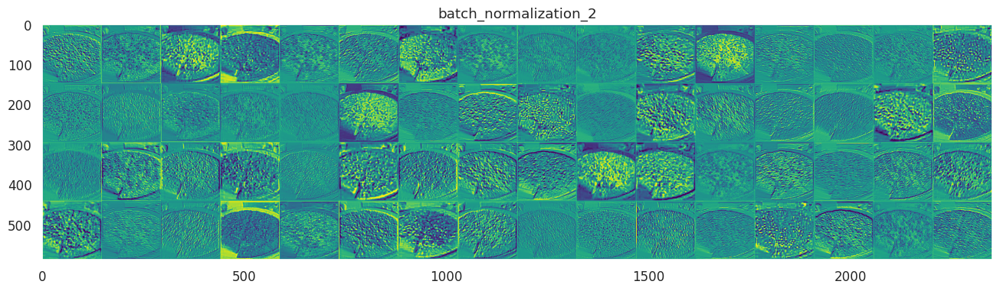

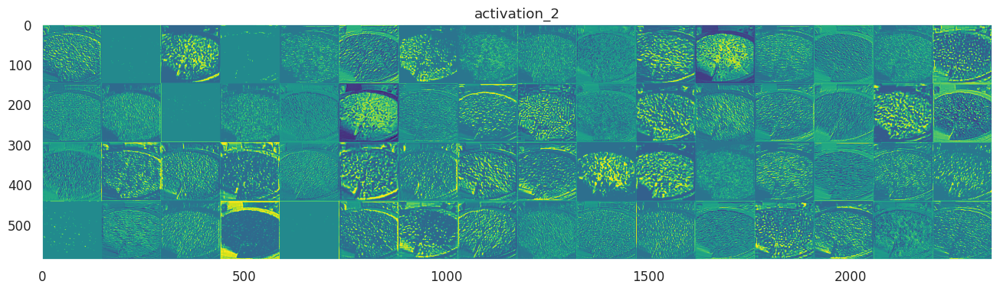

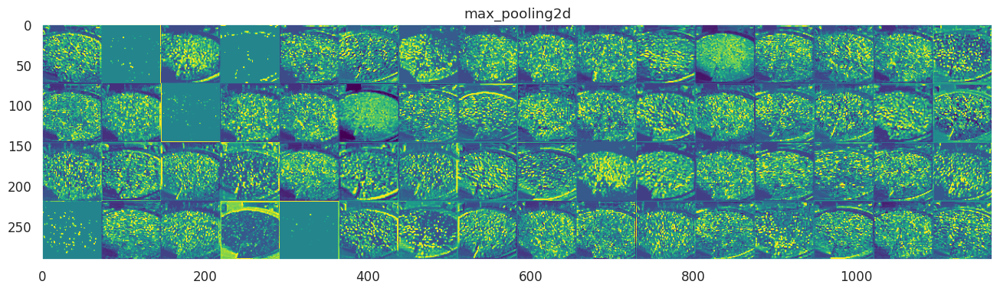

In [ ]:
food = '/content/drive/MyDrive/test_food/0070.jpg'
activations = get_activations(food,activations_output)
show_activations(activations, layer_names)

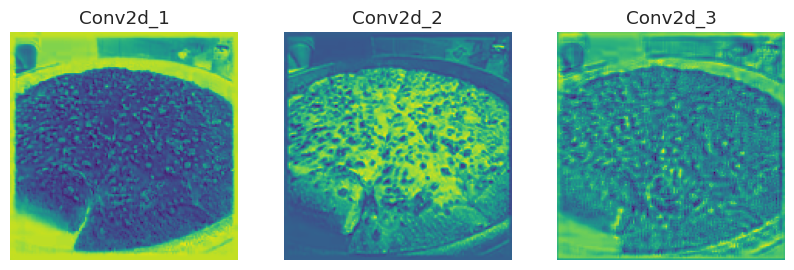

In [ ]:
activation_conv()

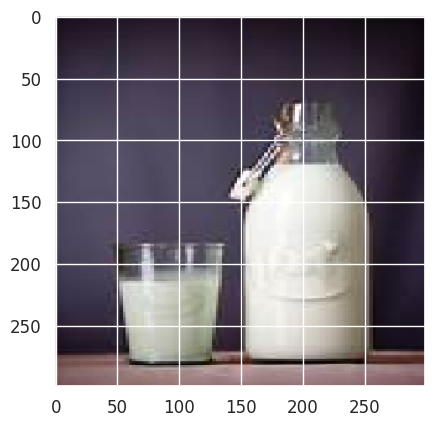

1/1 [==============================] - 0s 25ms/step


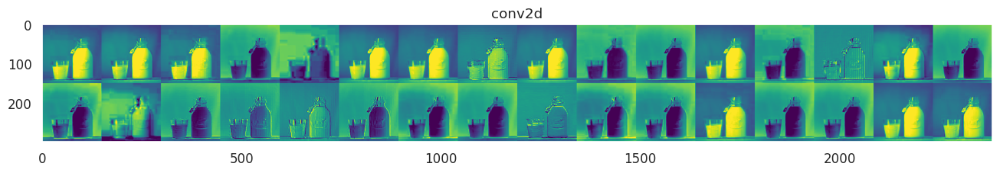

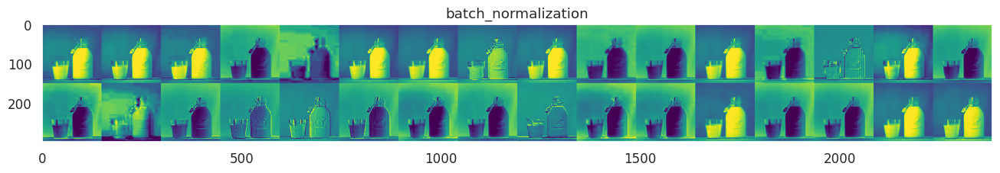

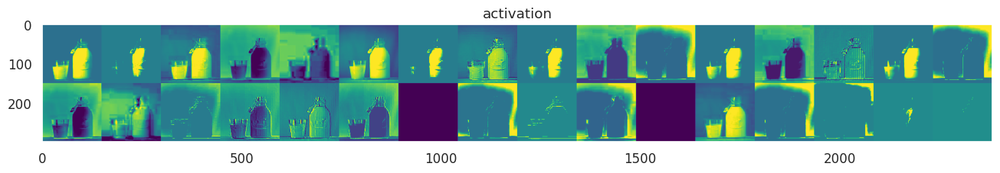

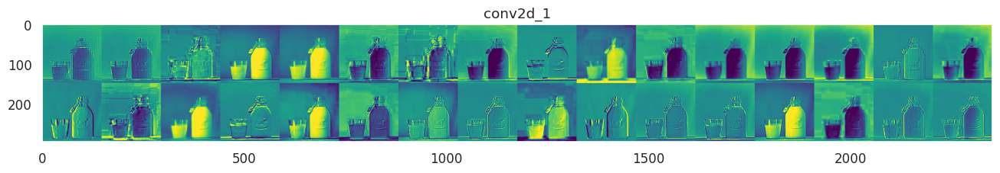

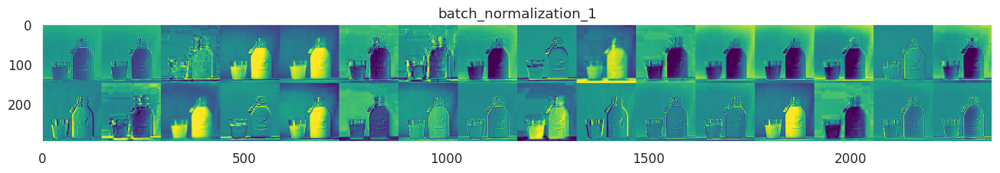

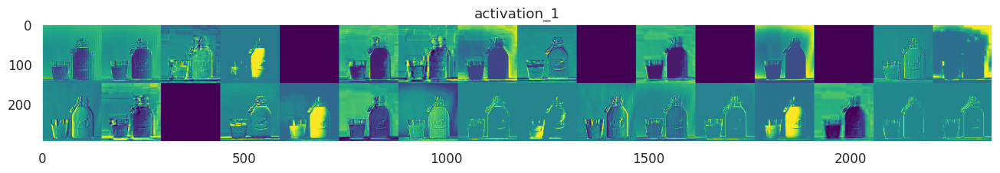

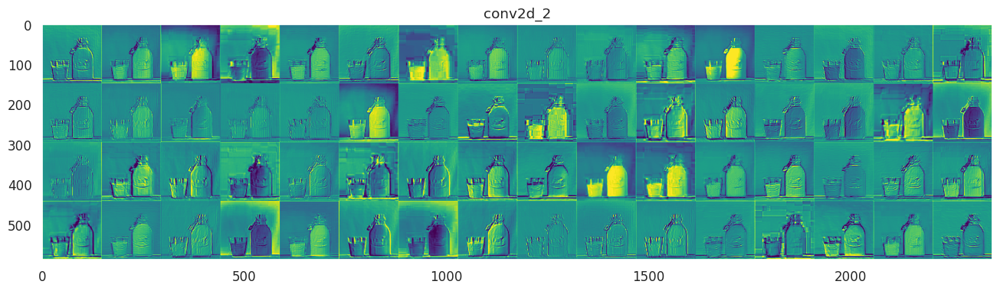

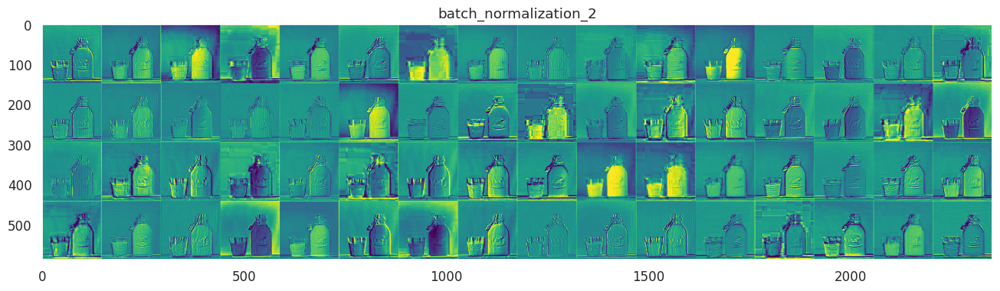

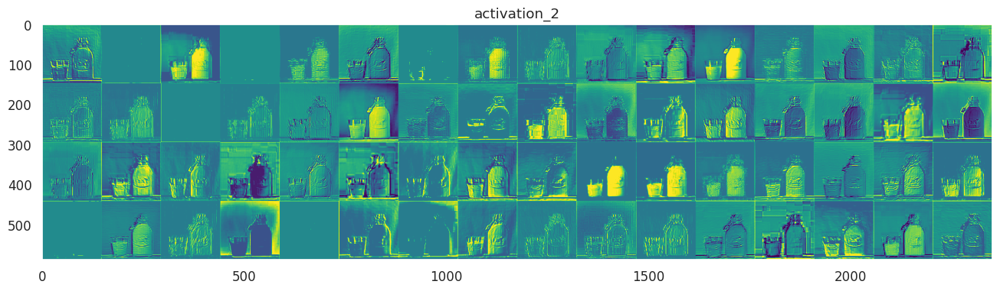

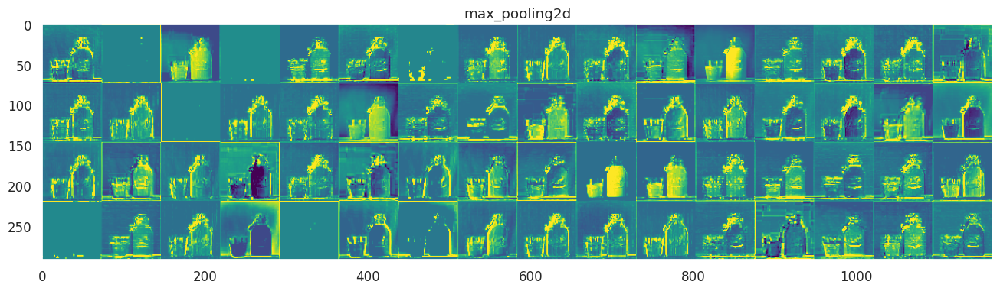

In [ ]:
food = '/content/drive/MyDrive/test_food/0059.jpg'
activations = get_activations(food,activations_output)
show_activations(activations, layer_names)

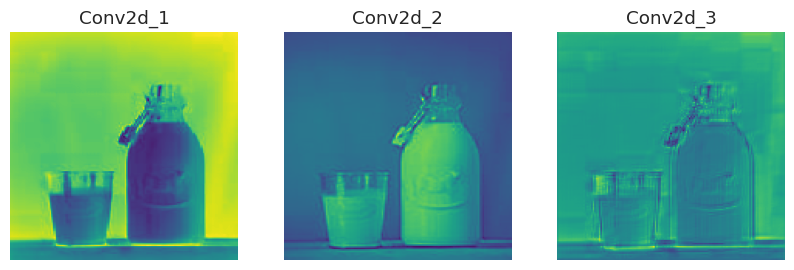

In [ ]:
activation_conv()

Instructions for updating:
Colocations handled automatically by placer.


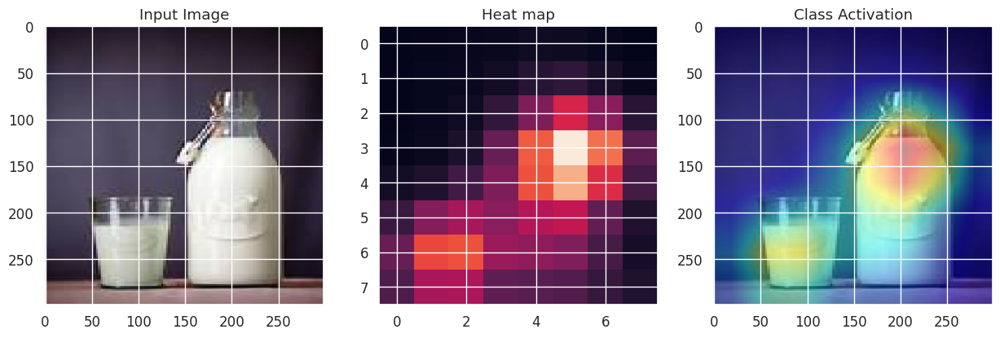

In [ ]:
pred = get_attribution('/content/drive/MyDrive/test_food/0059.jpg')


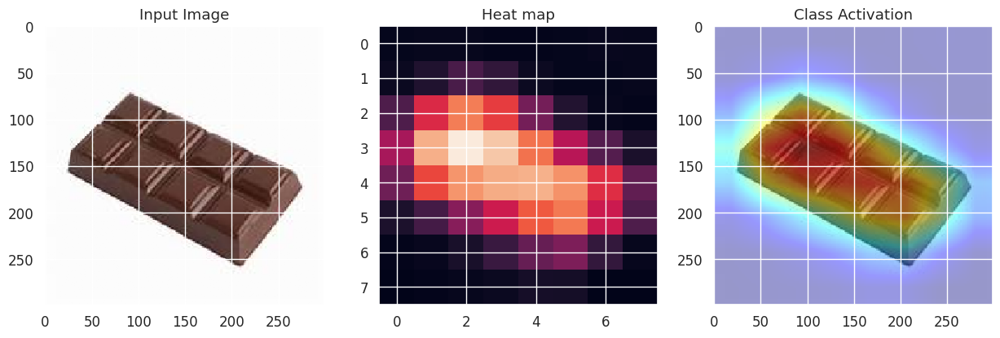

In [ ]:
pred2=get_attribution('/content/drive/MyDrive/test_food/0065.jpg')

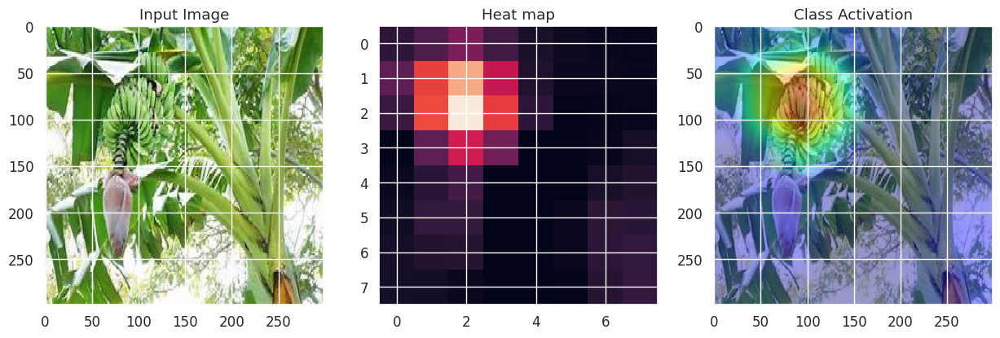

In [ ]:
pred3=get_attribution('/content/drive/MyDrive/test_food/0072.jpg')

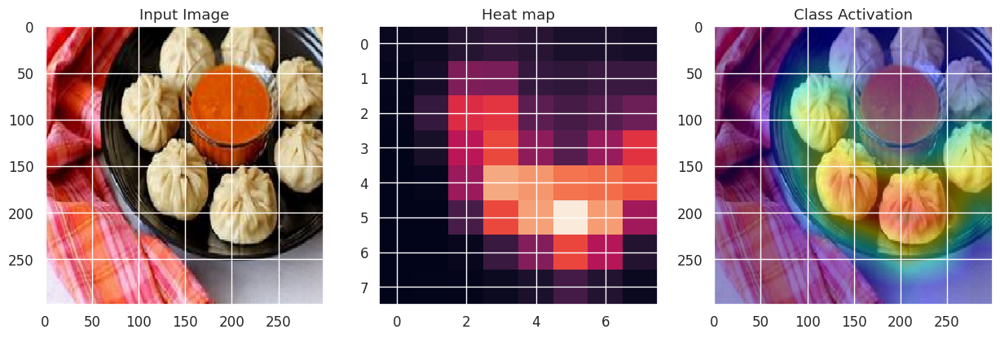

In [ ]:
pred5=get_attribution('/content/drive/MyDrive/test_food/0026.jpg')

In [ ]:
!wget -O download.jpg https://www.cookwithmanali.com/wp-content/uploads/2015/01/Restaurant-Style-Dal-Makhani-Recipe.jpg

model_load = load_model('./model_v1_inceptionV3.h5')

--2023-11-09 17:33:16--  https://www.cookwithmanali.com/wp-content/uploads/2015/01/Restaurant-Style-Dal-Makhani-Recipe.jpg
Resolving www.cookwithmanali.com (www.cookwithmanali.com)... 172.67.41.67, 104.22.44.178, 104.22.45.178, ...
Connecting to www.cookwithmanali.com (www.cookwithmanali.com)|172.67.41.67|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 154355 (151K) [image/jpeg]
Saving to: ‘download.jpg’

download.jpg        100%[===================>] 150.74K  --.-KB/s    in 0.03s   

2023-11-09 17:33:17 (4.58 MB/s) - ‘download.jpg’ saved [154355/154355]



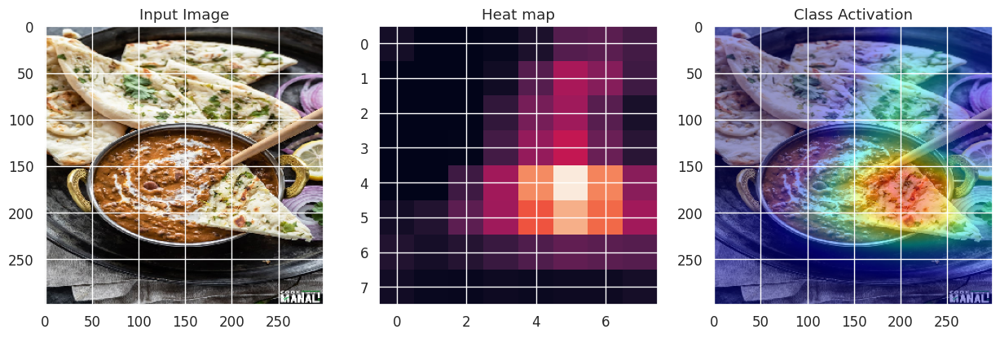

In [ ]:
pred = get_attribution('download.jpg')

In [ ]:
#Nutrition Analysis
# -*- coding: utf-8 -*-

from __future__ import division, print_function
# coding=utf-8
import sys
import os
import glob
import re
import numpy as np
import tensorflow as tf
import tensorflow as tf

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.2
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)
# Keras
from tensorflow.keras.applications.resnet50 import preprocess_input
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image

# Flask utils
from flask import Flask, redirect, url_for, request, render_template
from werkzeug.utils import secure_filename
#from gevent.pywsgi import WSGIServer

# Define a flask app
app = Flask(__name__)

# Model saved with Keras model.save()
MODEL_PATH ='model_v1_inceptionV3.h5'

# Load your trained model
model = load_model(MODEL_PATH)




def model_predict(img_path, model):
    print(img_path)
    img = image.load_img(img_path, target_size=(299, 299))

    # Preprocessing the image
    x = image.img_to_array(img)
    # x = np.true_divide(x, 255)
    ## Scaling
    x=x/255
    x = np.expand_dims(x, axis=0)


    # Be careful how your trained model deals with the input
    # otherwise, it won't make correct prediction!
   # x = preprocess_input(x)

    preds = model.predict(x)
    preds=np.argmax(preds, axis=1)
    if preds==7:
        preds="EGG\n Nutrition Analysis(1 Egg-34g)\n*Carbohydrates:0.802g\n*Minerals: Selenium se- 6.09 micro g\n*Vitamins:\n  Riboflavin- 0.133 mg\n*Amino acids:\n   Tryptophan-0.064	g\n  Isoleucine-0.207	g\n     Leucine-0.347	g\n   Lysine-0.279	g\n      Methionine-0.165	g\n   Phenylalanine-0.247	g\n    Tyrosine-0.158	g\n     Valine-0.265	g\n  Arginine-0.235	g\n  Histidine-0.087	g\n   Alanine-0.243	g\n Aspartic acid-0.452	g\n   Glutamic acid-0.598	g\n  Glycine-0.143	g\n  Proline-0.168	g\n   Serine-0.291	g\n    Hydroxyproline-<0.01	g\n    Cysteine-0.138	g"

    return preds


@app.route('/', methods=['GET'])
def index():
    # Main page
    return render_template('index.html')


@app.route('/predict', methods=['GET', 'POST'])
def upload():
    if request.method == 'POST':
        # Get the file from post request
        f = request.files['file']

        # Save the file to ./uploads
        basepath = os.path.dirname(__file__)
        file_path = os.path.join(
            basepath, 'uploads', secure_filename(f.filename))
        f.save(file_path)

        # Make prediction
        preds = model_predict(file_path, model)
        result=preds
        return result
    return None


if __name__ == '__main__':
    app.run(port=5001,debug=True)

OSError: ignored

In [ ]:
print("EGG\n Nutrition Analysis(1 Egg-34g)\n*Carbohydrates:0.802g\n*Minerals: Selenium se- 6.09 micro g\n*Vitamins:\n  Riboflavin- 0.133 mg\n*Amino acids:\n   Tryptophan-0.064	g\n  Isoleucine-0.207	g\n     Leucine-0.347	g\n   Lysine-0.279	g\n      Methionine-0.165	g\n   Phenylalanine-0.247	g\n    Tyrosine-0.158	g\n     Valine-0.265	g\n  Arginine-0.235	g\n  Histidine-0.087	g\n   Alanine-0.243	g\n Aspartic acid-0.452	g\n   Glutamic acid-0.598	g\n  Glycine-0.143	g\n  Proline-0.168	g\n   Serine-0.291	g\n    Hydroxyproline-<0.01	g\n    Cysteine-0.138	g")

EGG
 Nutrition Analysis(1 Egg-34g)
*Carbohydrates:0.802g
*Minerals: Selenium se- 6.09 micro g
*Vitamins:
  Riboflavin- 0.133 mg
*Amino acids:
   Tryptophan-0.064	g
  Isoleucine-0.207	g
     Leucine-0.347	g
   Lysine-0.279	g
      Methionine-0.165	g
   Phenylalanine-0.247	g
    Tyrosine-0.158	g
     Valine-0.265	g
  Arginine-0.235	g
  Histidine-0.087	g
   Alanine-0.243	g
 Aspartic acid-0.452	g
   Glutamic acid-0.598	g
  Glycine-0.143	g
  Proline-0.168	g
   Serine-0.291	g
    Hydroxyproline-<0.01	g
    Cysteine-0.138	g
